In [46]:
# Loading the libraries data
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from time import sleep
from os import listdir
import matplotlib.image as mpimg
from matplotlib.animation import FuncAnimation as FA
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 50)

## Task 1: Load data

In [47]:
# Loading the data
train_df = pd.read_csv("../dat/train_FD001.txt", header=None, sep = ' ')
test_df = pd.read_csv("../dat/test_FD001.txt", header=None, sep = ' ')
rul_df = pd.read_csv("../dat/RUL_FD001.txt", header=None)

In [48]:
#display the top columns/rows
for df in [train_df, test_df, rul_df]:
    display(df.head(128))

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,1,124,0.0025,0.0002,100.0,518.67,642.48,1587.14,1402.28,14.62,21.61,552.26,2388.13,9053.03,1.3,47.55,521.40,2388.13,8133.82,8.4416,0.03,393,2388,100.0,38.80,23.2341,NaN,NaN
124,1,125,-0.0004,0.0005,100.0,518.67,642.96,1585.47,1406.42,14.62,21.61,552.44,2388.13,9046.16,1.3,47.63,521.57,2388.11,8126.33,8.4079,0.03,394,2388,100.0,38.68,23.3039,NaN,NaN
125,1,126,0.0016,0.0001,100.0,518.67,642.49,1582.64,1418.50,14.62,21.61,553.72,2388.05,9049.11,1.3,47.49,521.35,2388.08,8130.94,8.4378,0.03,392,2388,100.0,38.85,23.2289,NaN,NaN
126,1,127,-0.0010,0.0002,100.0,518.67,642.99,1586.90,1399.49,14.62,21.61,553.81,2388.09,9047.90,1.3,47.63,521.34,2388.10,8133.00,8.4626,0.03,393,2388,100.0,38.91,23.2772,NaN,NaN


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,NaN,NaN
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,NaN,NaN
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,3,44,-0.0019,0.0000,100.0,518.67,642.16,1586.46,1410.72,14.62,21.61,552.95,2388.13,9055.43,1.3,47.59,521.77,2388.14,8133.77,8.4204,0.03,394,2388,100.0,38.74,23.3035,NaN,NaN
124,3,45,0.0003,-0.0004,100.0,518.67,642.55,1588.36,1405.75,14.62,21.61,552.30,2388.13,9058.30,1.3,47.57,521.00,2388.14,8125.84,8.4227,0.03,394,2388,100.0,38.86,23.3064,NaN,NaN
125,3,46,-0.0006,-0.0002,100.0,518.67,642.45,1587.99,1401.94,14.62,21.61,553.75,2388.09,9055.86,1.3,47.55,521.21,2388.09,8127.02,8.4210,0.03,393,2388,100.0,38.83,23.1494,NaN,NaN
126,3,47,0.0015,-0.0005,100.0,518.67,642.63,1587.05,1407.79,14.62,21.61,553.60,2388.14,9051.69,1.3,47.56,520.81,2388.11,8137.44,8.4516,0.03,394,2388,100.0,38.88,23.3113,NaN,NaN


,0
0,112
1,98
2,69
3,82
4,91
...,...
95,137
96,82
97,59
98,117


Let's review the descriptions of the columns in the csv files.

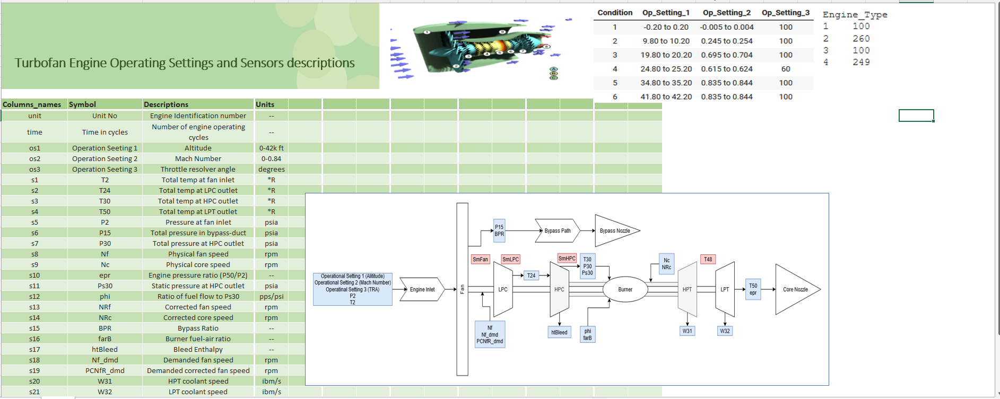

In [49]:
from IPython.display import Image, display

col_desc = '../dat/engine-settings-sensors-descriptions.png'
display(Image(col_desc))

Let's attach column names: 3 operational setting columns (os + number), and 21 sensor columns (s + number). 
Thereafter drop the last 2 columns with NaNs

In [50]:
col_names = []

col_names.append('unit')
col_names.append('time')

for i in range(1,4):
    col_names.append('os'+str(i))
for i in range(1,22):
    col_names.append('s'+str(i))

train_df = train_df.iloc[:,:-2].copy()
train_df.columns = col_names
display(train_df.head())

test_df = test_df.iloc[:,:-2].copy()
test_df.columns = col_names
display(test_df.head())

,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


Let's attach the RUL (remaining useful lifetime) values to the datasets

In [51]:
rul_list = []

for n in np.arange(1,101):
    
    time_list = np.array(train_df[train_df['unit'] == n]['time'])
    length = len(time_list)
    rul = list(length - time_list)
    rul_list += rul
    
train_df['rul'] = rul_list

For the test data, we have the 'solutions' for the test engines in a separate file called rul_df (the name that I used for dataframe). 
I will use that to attach the RUL values for the test as well.

In [52]:

rul_list = []

for n in np.arange(1,101):
    
    time_list = np.array(test_df[test_df['unit'] == n]['time'])
    length = len(time_list)
    rul_val = rul_df.iloc[n-1].item()
    rul = list(length - time_list + rul_val)
    rul_list += rul

test_df['rul'] = rul_list

In [53]:
# Let's display the updated dataframes for train and test datasets with RULs

for df in [train_df, test_df]:
    display(df.head())



,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21,rul
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187


,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21,rul
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,142
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,141
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,140
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,139
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,138


## Task 2: Understand data

Our goal here is to predict the remaining useful life of the engine to schedule maintenance. 
To do this, we will want to identify the most important features for classification and maintenance prioritization. 

Before digging into each column, let's leverage `pandas_profiling`, to get a big picture of our data set. 

In [54]:
from pandas_profiling import ProfileReport

profile = ProfileReport(train_df, title="Pandas Profiling Engine Remaining Useful Life Report")

Let's show the report inside the notebook, go over the report and check each tab; especially the "Alerts". 

In [55]:
%%time
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 2min 57s, sys: 2min 52s, total: 5min 50s
Wall time: 2min 10s


2. Pandas profiling Profile reports that there are 19 numeric variables and 8 categorical variables. Let's print out the datatype of each feature (column) and understand how the profiler infers data type.

In [56]:
train_df.dtypes

unit      int64
time      int64
os1     float64
os2     float64
os3     float64
s1      float64
s2      float64
s3      float64
s4      float64
s5      float64
s6      float64
s7      float64
s8      float64
s9      float64
s10     float64
s11     float64
s12     float64
s13     float64
s14     float64
s15     float64
s16     float64
s17       int64
s18       int64
s19     float64
s20     float64
s21     float64
rul       int64
dtype: object

3. From the report, we see that these 8 features `os3`, `s1`, `s5`, `s6`, `s10`, `s16`, `s18`, `s19` were "Rejected" as they have constant values for each column. 
These features are not informative, so we remove the 8 features from both the training and test sets. 


In [57]:
drop_cols1 = ['os3', 's1', 's5', 's6','s10', 's16', 's18', 's19'] 

train_df = train_df.drop(drop_cols1, axis = 1)
test_df = test_df.drop(drop_cols1, axis = 1)

for df in [train_df, test_df]:
    display(df.head())

,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187


,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735,142
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916,141
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166,140
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737,139
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130,138


In [58]:
train_df.shape

(20631, 19)

In [59]:
test_df.shape

(13096, 19)

## Task 3: Preprocess Data

5. Let's visualize the selected features relationship with Remaining Useful Life.

   For faster rendering, we will use the subset `train_df_reduced`. 

NameError: name 'fig' is not defined

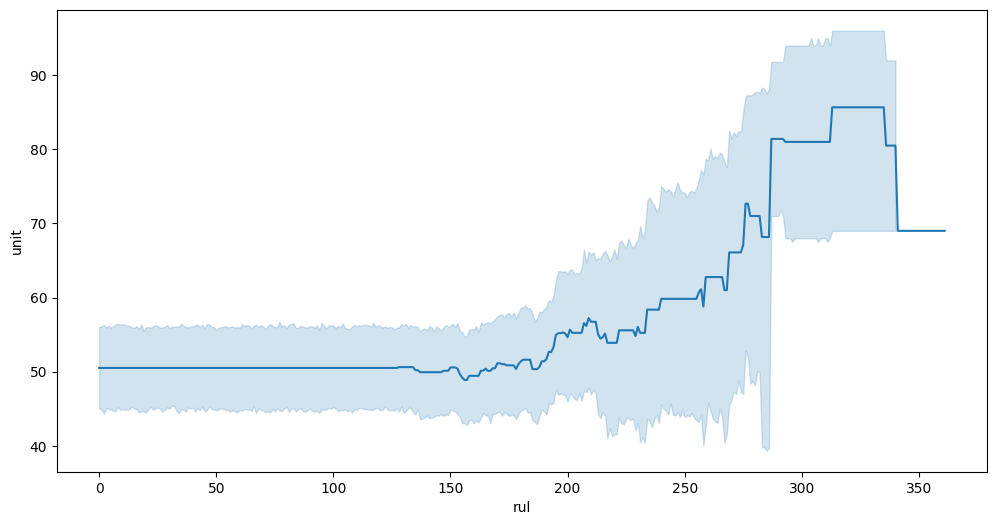

In [60]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
    
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df, x='rul', y='unit');
fig.tight_layout()


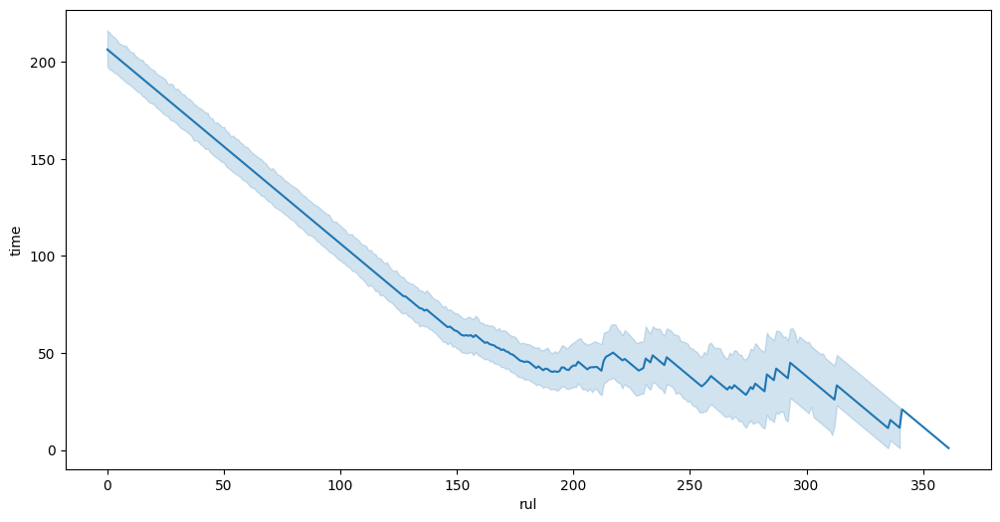

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='time');
fig.tight_layout()

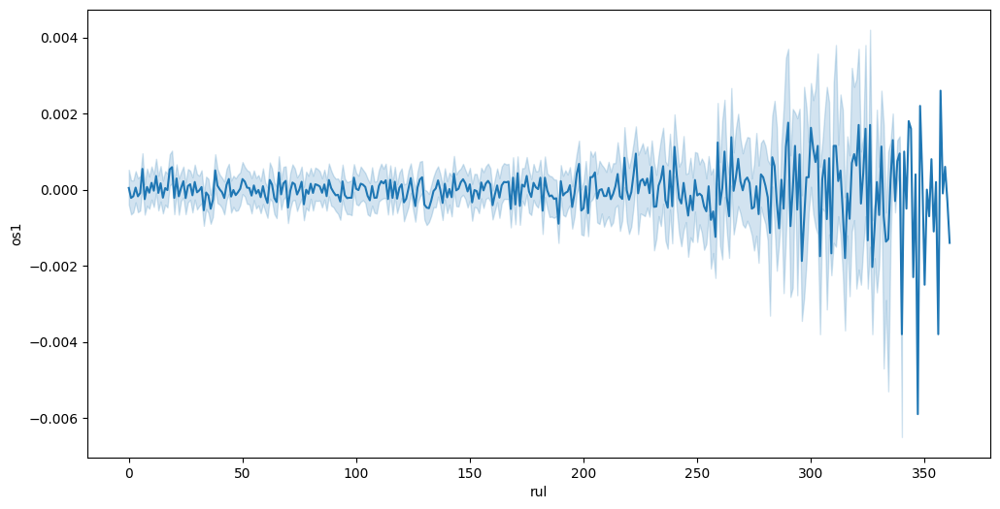

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='os1');
fig.tight_layout()

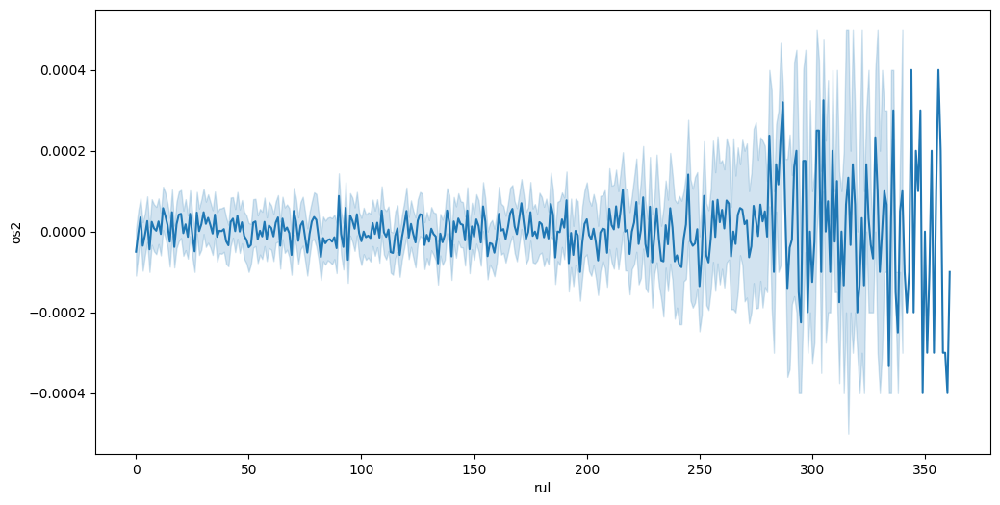

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='os2');
fig.tight_layout()

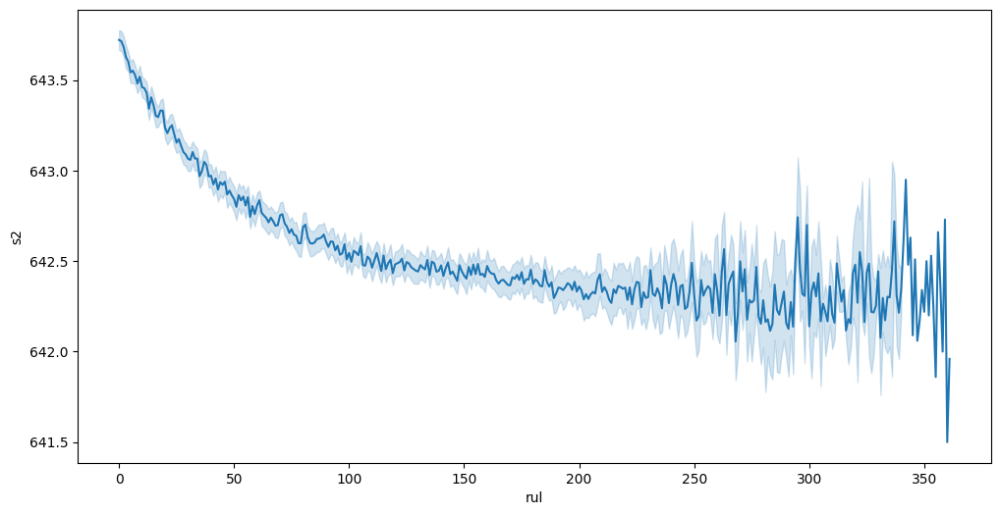

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s2');
fig.tight_layout()

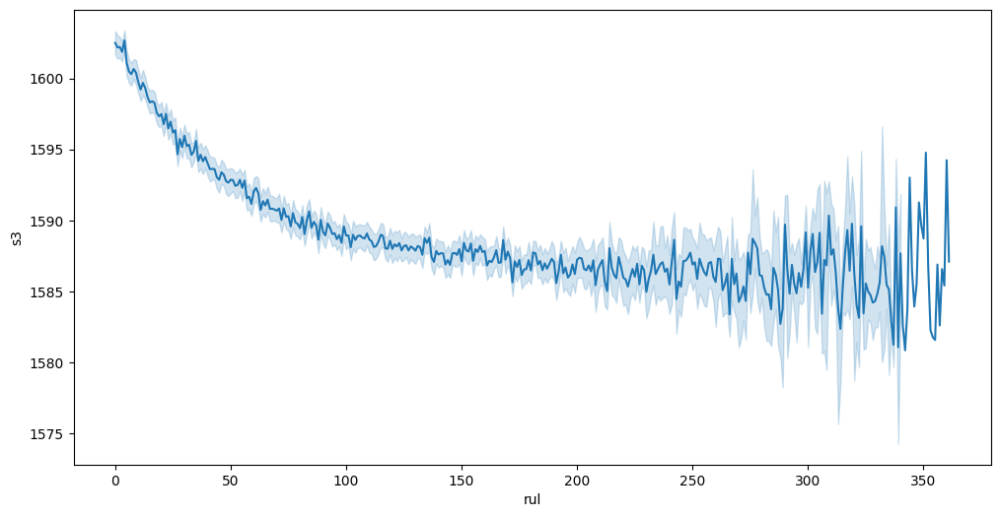

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s3');
fig.tight_layout()

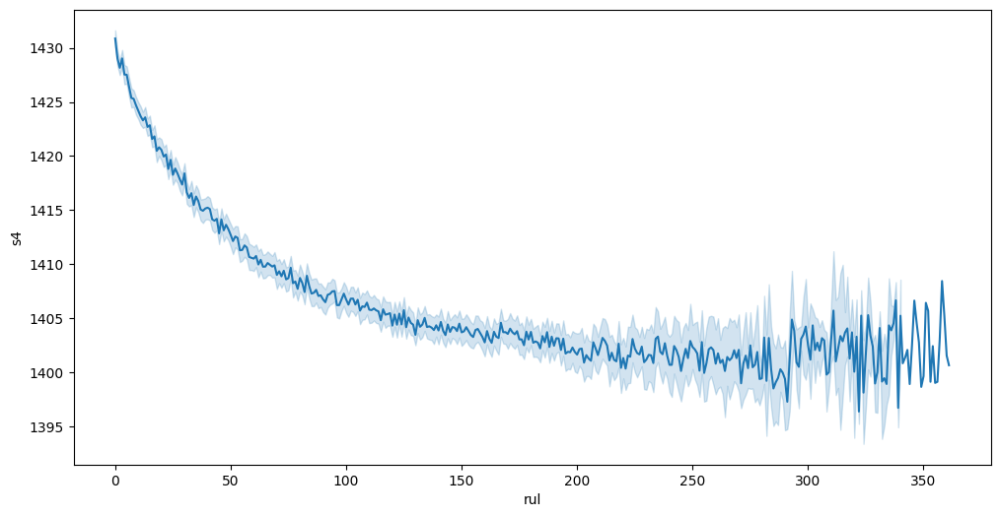

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s4');
fig.tight_layout()

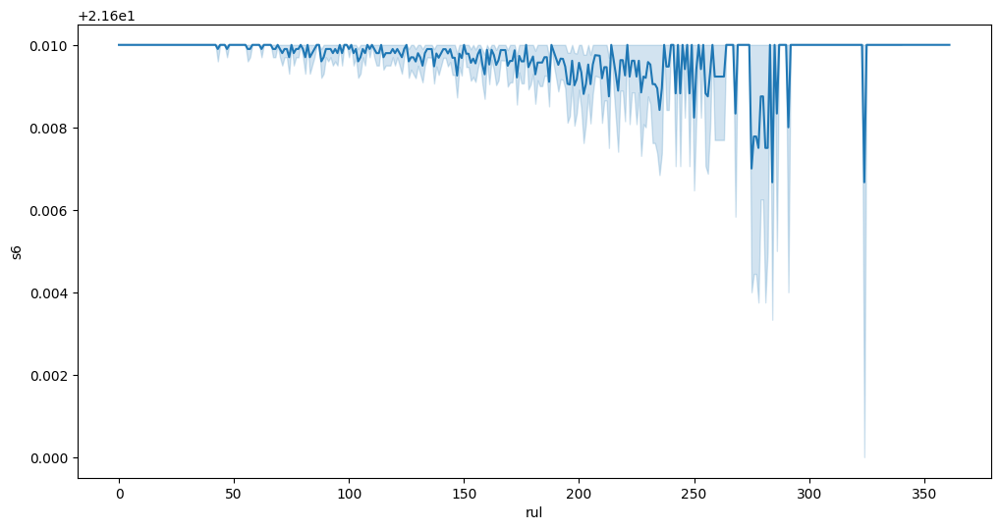

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s6');
fig.tight_layout()

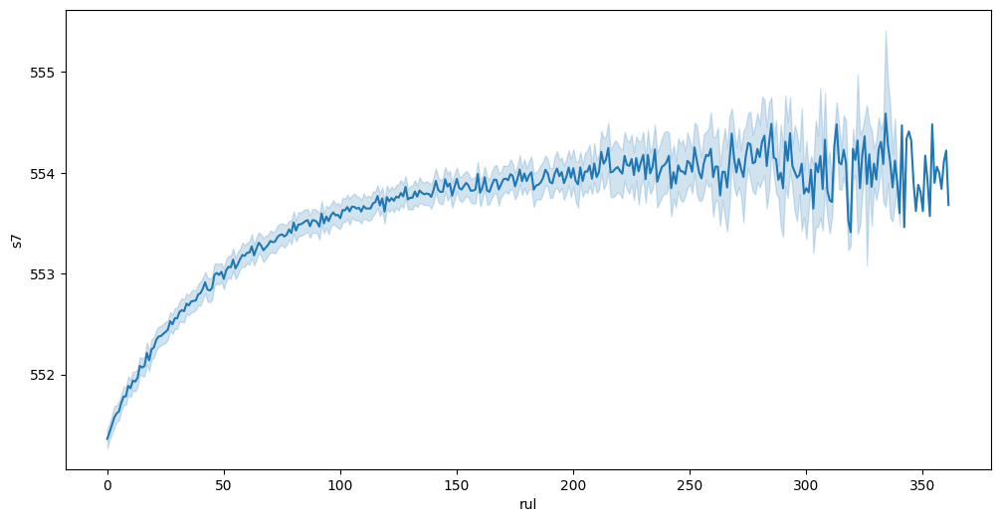

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s7');
fig.tight_layout()

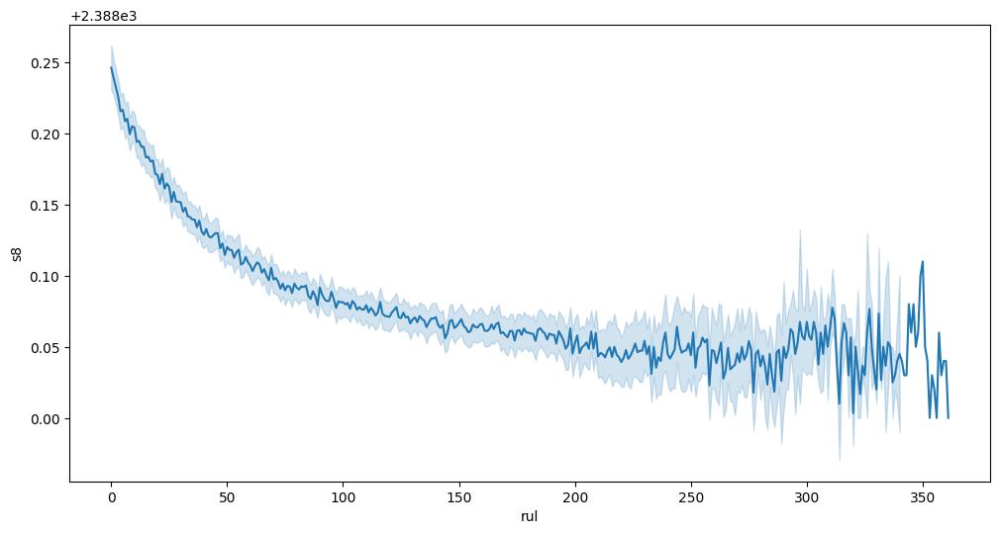

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s8');
fig.tight_layout()

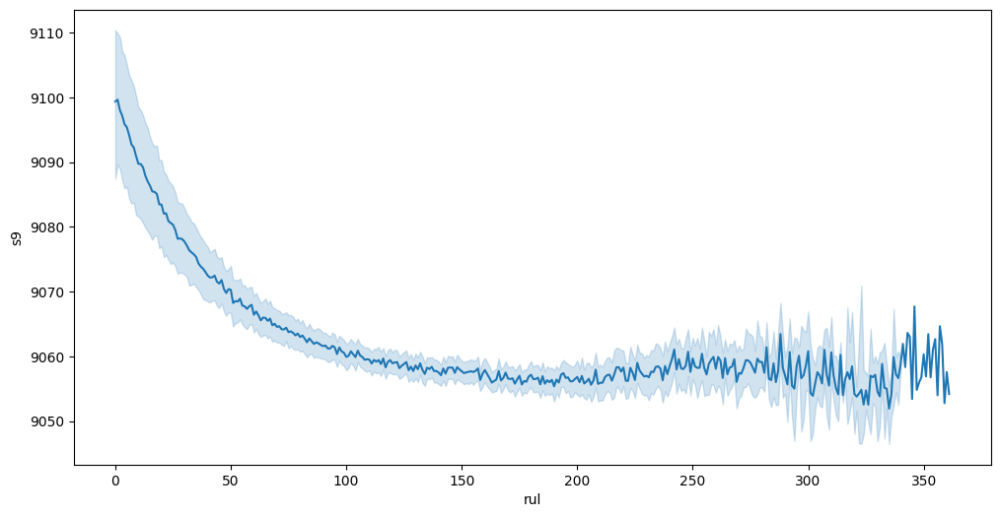

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s9');
fig.tight_layout()

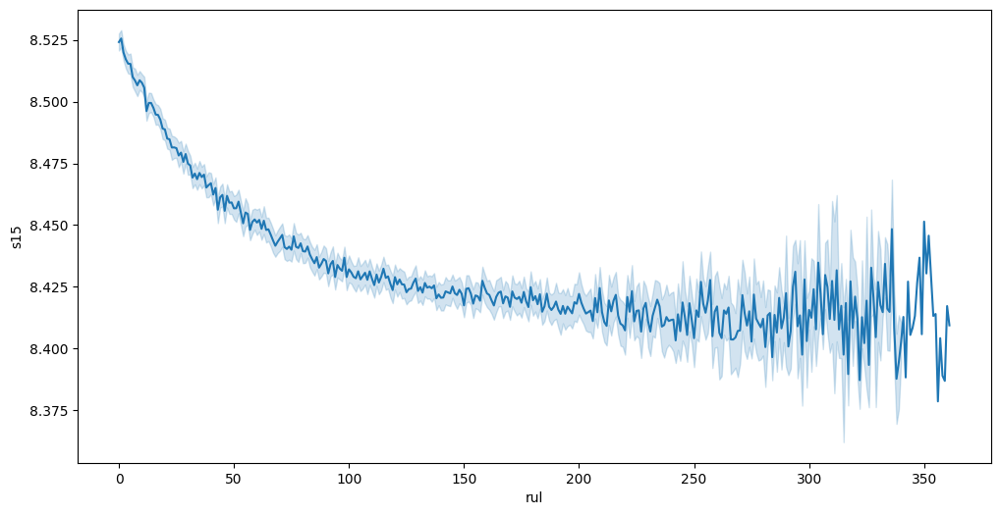

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s15');
fig.tight_layout()

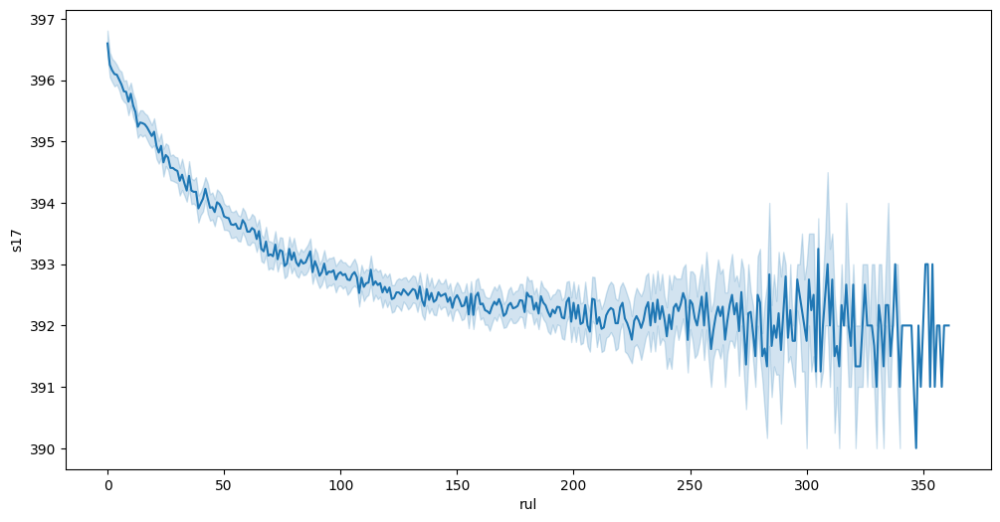

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s17');
fig.tight_layout()

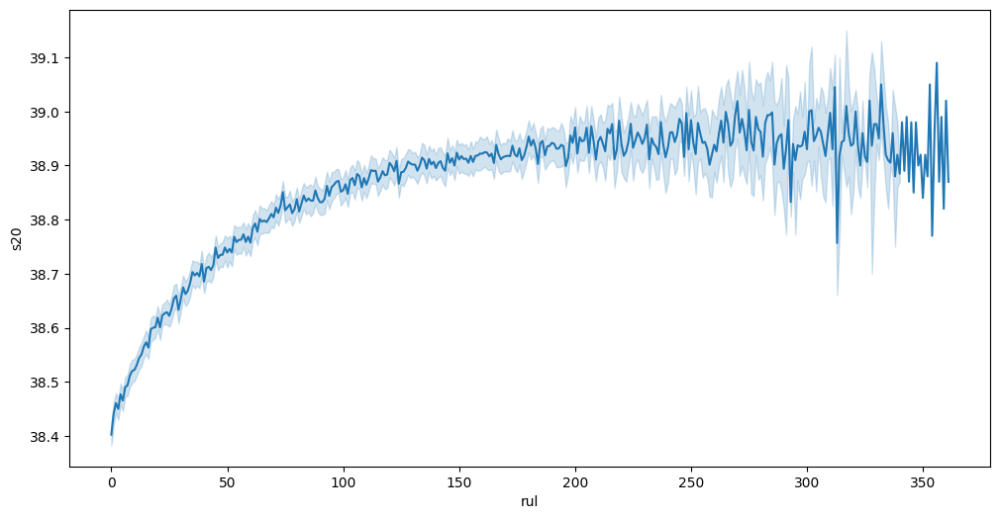

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s20');
fig.tight_layout()

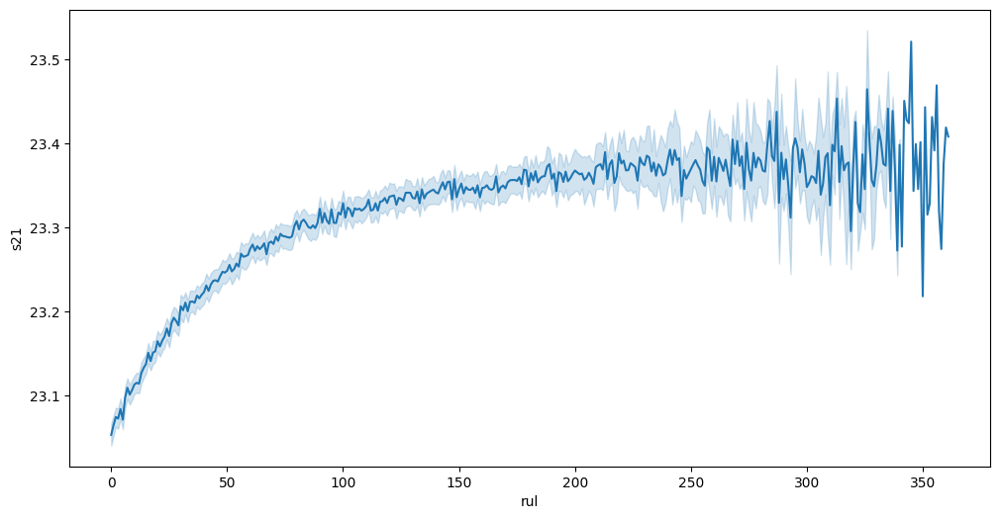

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=train_df_reduced, x='rul', y='s21');
fig.tight_layout()

6. Time Series Preprocessing For Sensor Values Using Exponentially Weighted Average

In [61]:
#Smoothing Function: Exponentially Weighted Averages

def smooth(s, b = 0.98):

    v = np.zeros(len(s)+1) #v_0 is already 0.
    bc = np.zeros(len(s)+1)

    for i in range(1, len(v)): #v_t = 0.95
        v[i] = (b * v[i-1] + (1-b) * s[i-1]) 
        bc[i] = 1 - b**i

    sm = v[1:] / bc[1:]
    
    return sm

s = [1,2,3,4,5]
print(s)
print(f'After Smoothing: {smooth(s)}')

[1, 2, 3, 4, 5]
After Smoothing: [1.         1.50505051 2.01346756 2.52525046 3.04039827]


In [62]:
#Smoothing each time series for each engine in both training and test sets

for c in train_df.columns:
    
    if 's' in c:
        sm_list = []

        for n in np.arange(1,101):
            s = np.array(train_df[train_df['unit'] == n][c].copy())
            sm = list(smooth(s, 0.98))
            sm_list += sm
        
        train_df[c+'_smoothed'] = sm_list
        
for c in test_df.columns:
    
    if 's' in c:
        sm_list = []

        for n in np.arange(1,101):
            s = np.array(test_df[test_df['unit'] == n][c].copy())
            sm = list(smooth(s, 0.98))
            sm_list += sm
        
        test_df[c+'_smoothed'] = sm_list

Let's take a look at how smoothed values (salmon) look compared to the original series (lightblue), for a particular sensor (unit 10 from train)

KeyError: 'os1_smoothed'

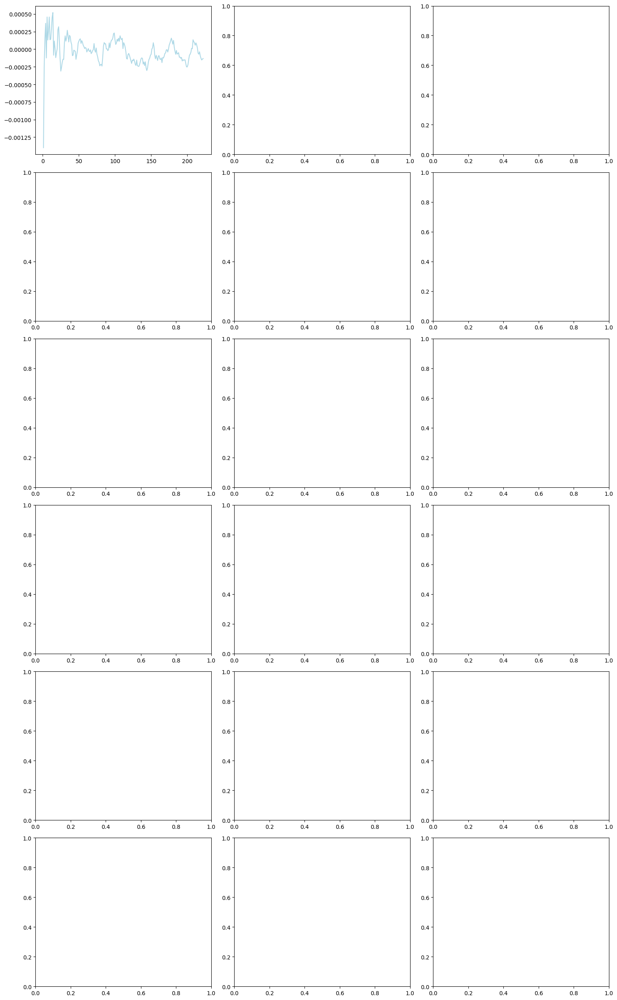

In [66]:
sample_df = train_df[train_df['unit'] == 10].copy()

fig, axes = plt.subplots(6,3, figsize = (15,25))
fig.tight_layout()

j = -1
for c in train_df.columns:
    
    if ('s' in c) and ('smoothed' not in c):
        j += 1
        axes[j // 3, j % 3].plot(sample_df['time'], sample_df[c], c = 'lightblue', label = 'original')
        axes[j // 3, j % 3].plot(sample_df['time'], sample_df[c+'_smoothed'], c = 'salmon', label = 'smoothed')
        axes[j // 3, j % 3].plot([10,10],[0,1], c = 'black')
        axes[j // 3, j % 3].set_title(c)
        axes[j // 3, j % 3].legend()

In [68]:
#Remove the original series

for c in train_df.columns:
    if ('s' in c) and ('smoothed' not in c):
        train_df[c] = train_df[c+'_smoothed']
        train_df.drop(c+'_smoothed', axis = 1, inplace = True)
        
for c in test_df.columns:
    if ('s' in c) and ('smoothed' not in c):
        test_df[c] = test_df[c+'_smoothed']
        test_df.drop(c+'_smoothed', axis = 1, inplace = True)
        
for df in [train_df, test_df]:
    display(df.head())

KeyError: 'os1_smoothed'

 When we look at the length of the trajectories for each unit in both the training and test sets, thus 200 engines, we see that for the training set that had the entire trajectories, have minimum length of 128. However, for the test set, we have a minimum value of 31. This means that if we were to predict the final RUL for every test engine unit, we cannot use a window size greater than 31 for training the model. Furthermore, if you take a look at the smoothed series visualization, I put a black vertical line for every graph, at about time step 10. This is because, when we smooth using exponentially weighted averages, seems like in the beginning, the smoothing process is sort of 'warming up'? So it seems a little shaky. Thus, I will be taking that part out of the training process. This will happen for test data as well. Thus, the maximum window size we can take is 31 - 10 = 21. I will go with 20.

In [ ]:
print('training set time cycles:')
display(train_df.groupby('unit')['time'].max().describe())
print('test set time cycles:')
display(test_df.groupby('unit')['time'].max().describe())

training set time cycles:


count    100.000000
mean     206.310000
std       46.342749
min      128.000000
25%      177.000000
50%      199.000000
75%      229.250000
max      362.000000
Name: time, dtype: float64

test set time cycles:


count    100.000000
mean     130.960000
std       53.593479
min       31.000000
25%       88.750000
50%      133.500000
75%      164.250000
max      303.000000
Name: time, dtype: float64

In [ ]:
n_features = len([c for c in train_df.columns if 's' in c])
window = 20
print(f'number of features: {n_features}, window size: {window}')

number of features: 13, window size: 20


7. Make the NumPy arrays `X_train`, `X_test`, `y_train` and `y_test` from `train_df` and `test_df`.

In [ ]:
y_train = train_df['rul'].values
y_test = test_df['rul'].values 
X_train = train_df.drop(['rul','time','unit'], axis = 1).values
X_test = test_df.drop(['rul','time','unit'], axis = 1).values

8. Scale the features in `X_train` and `X_test` using `MinMaxScaler`

In [ ]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

In [ ]:
X_train

array([[0.45977011, 0.16666667, 0.18373494, ..., 0.33333333, 0.71317829,
        0.7246617 ],
       [0.6091954 , 0.25      , 0.28313253, ..., 0.33333333, 0.66666667,
        0.73101353],
       [0.25287356, 0.75      , 0.34337349, ..., 0.16666667, 0.62790698,
        0.62137531],
       ...,
       [0.52298851, 0.5       , 0.66566265, ..., 0.83333333, 0.23255814,
        0.05399061],
       [0.43678161, 0.75      , 0.60843373, ..., 0.58333333, 0.11627907,
        0.23446562],
       [0.31609195, 0.08333333, 0.79518072, ..., 0.66666667, 0.17829457,
        0.21817178]])

## Task 4: Build Baseline Regression Models

1. Let's start with a simple Linear Regression model

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import (mean_squared_error, r2_score)
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

LinearRegression()

In [ ]:
lr_pred = lr_model.predict(X_test)

2. Let's calculate the metrics for the LinearRegression model. 

In [ ]:
lr_model.intercept_

159.66763279012184

In [ ]:
pd.DataFrame(zip(train_df.drop(['rul','time','unit'], axis = 1).columns, 
                 np.transpose(lr_model.coef_)), columns=['features', 'coef'])

,features,coef
0,os1,0.826179
1,os2,1.953972
2,s2,-33.150176
3,s3,-29.391763
4,s4,-66.270956
5,s6,-6.112547
6,s7,63.249213
7,s8,-35.907189
8,s9,-128.273575
9,s15,-44.203237


In [ ]:
lr_model.score(X_test, y_test)

-0.23894935994580546

In [ ]:
print("Mean squared error: %.2f" % mean_squared_error(y_test, lr_pred))

print("Coefficient of determination: %.2f" % r2_score(y_test, lr_pred))

Mean squared error: 4309.55
Coefficient of determination: -0.24
